In [1]:
!pip install evaluate


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.0/84.0 kB 2.5 MB/s eta 0:00:00


In [2]:
import pandas as pd

import torch

from torch.utils.data import DataLoader, Dataset


from lime.lime_text import LimeTextExplainer

import shap

import numpy as np

from datasets import DatasetDict, Dataset, Features, Value, ClassLabel

from evaluate import load

In [3]:
# Check if GPU is available

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

print(f'Using device: {device}')

Using device: cpu


In [4]:
label_mapping ={'anger': 0,
 'disgust': 1,
 'fear': 2,
 'happy': 3,
 'sad': 4,
 'shame': 5,
 'surprise': 6}

In [5]:
from evaluate import load
from transformers import pipeline, AutoTokenizer, AutoModelForSequenceClassification, AutoModelForQuestionAnswering

# Load classification model and tokenizer
classification_model_path = '/kaggle/input/ece-using-extractive-question-answering/classification'
classifier_tokenizer = AutoTokenizer.from_pretrained(classification_model_path)
classifier_model = AutoModelForSequenceClassification.from_pretrained(classification_model_path)

# Load QA model and tokenizer
qa_model_path = '/kaggle/input/ece-using-extractive-question-answering/question_answering'
qa_tokenizer = AutoTokenizer.from_pretrained(qa_model_path)
qa_model = AutoModelForQuestionAnswering.from_pretrained(qa_model_path)

# Pipelines for classification and QA
classification_pipeline = pipeline("text-classification", model=classifier_model, tokenizer=classifier_tokenizer)
qa_pipeline = pipeline("question-answering", model=qa_model, tokenizer=qa_tokenizer)

In [6]:
test_data=pd.read_csv('/kaggle/input/data-preprocessing-for-emotion-cause-extraction/test_data.csv')

In [7]:
test_data

,context,label,question,start_positions,end_positions,answer
0,"That is encouraging , yet we are concerned tha...",2,Why does this sentence express fear?,17,23,that people are still getting fatter
1,We all feel sad that we couldn't go on vacatio...,4,Why does this sentence express sad?,13,21,that we couldn't go on vacation together
2,"Clive also attended , visibly gleeful that he ...",3,Why does this sentence express happy?,16,36,that he had spared the school any undesirable ...
3,He felt crushed insidewhen he thought about ho...,5,Why does this sentence express shame?,-1,-1,when he thought about how his actions had hurt...
4,He couldn’t contain his anger when the politic...,0,Why does this sentence express anger?,16,23,when the politician lied about the charity funds
...,...,...,...,...,...,...
240,The teacher was anger when she found out that ...,0,Why does this sentence express anger?,13,24,when she found out that the students had cheat...
241,He felt humiliatedwhen his mistake became the ...,5,Why does this sentence express shame?,-1,-1,when his mistake became the subject of convers...
242,His heart leaptwhen he found the missing item ...,6,Why does this sentence express surprise?,-1,-1,when he found the missing item he had been sea...
243,I'm sad my favorite TV show ended without a pr...,4,Why does this sentence express sad?,13,21,my favorite TV show ended without a proper con...


# Generate Emotion Stimulus

In [8]:

def emotion_analysis_with_explanation(context, classification_pipeline, qa_pipeline, label_mapping):
    # Step 1: Classification (Emotion Analysis)
    classification_result = classification_pipeline(context)
    predicted_label = classification_result[0]['label']  # Extract the predicted label (e.g., "LABEL_3")

    # Reverse the label_mapping to map numbers back to emotions
    reverse_label_mapping = {v: k for k, v in label_mapping.items()}

    # Get the appropriate emotion
    emotion = reverse_label_mapping[int(predicted_label.split("_")[1])]
    question = f"Why does this sentence express {emotion}?"

    # Step 3: Ask the QA Model
    qa_input = {"context": context, "question": question}
    qa_result = qa_pipeline(qa_input)

    # Output Results
    print(f"Text for Classification: {context}")
    print(f"Detected Emotion: {emotion}")
    print(f"Generated Question: {question}")
    print(f"Emotion Reason: {qa_result['answer']}")

    return {
        "text": context,
        "detected_emotion": emotion,
        "generated_question": question,
        "emotion_reason": qa_result['answer']
    }


# Generate Emotion Expression

## LIME EXPLANATION

In [9]:
from lime.lime_text import LimeTextExplainer
import torch

def explain_emotion_with_lime(context, emotion, classifier_tokenizer, classifier_model, device, classes=['anger','disgust','fear','happy','sad','shame','surprise']):
    """
    Generates an explanation for the detected emotion using LIME.

    Args:
    - context (str): The input text for emotion analysis.
    - emotion (str): The detected emotion to explain.
    - classifier_tokenizer: Tokenizer used for encoding the text.
    - classifier_model: The trained emotion classification model.
    - device: The device to run the model on (e.g., 'cpu' or 'cuda').
    - classes (list): List of emotion classes.
    
    Returns:
    - exp: The LIME explanation object.
    """
    # Define the prediction function for LIME
    def predict_proba(texts):
        # Tokenize and encode texts
        encodings = classifier_tokenizer(
            texts, 
            padding=True, 
            truncation=True, 
            max_length=256, 
            return_tensors="pt"
        )

        # Move tensors to device
        input_ids = encodings['input_ids'].to(device)
        attention_mask = encodings['attention_mask'].to(device)

        # Get logits and convert to probabilities
        with torch.no_grad():
            outputs = classifier_model(input_ids=input_ids, attention_mask=attention_mask)
            probs = torch.nn.functional.softmax(outputs.logits, dim=-1)

        # Return probabilities as a numpy array
        return probs.cpu().numpy()

    # Map the label name to its index
    label_index = classes.index(emotion)  # Get the index of the detected emotion
    
    # Create a LimeTextExplainer instance
    explainer = LimeTextExplainer(class_names=classes)

    # Generate LIME explanation using the index
    exp = explainer.explain_instance(context, predict_proba, labels=[label_index], num_features=20)

    return exp


## SHAP EXPLANATION

In [10]:
import datasets
import pandas as pd
import shap
import transformers

# Define the function to calculate and visualize SHAP values
def explain_emotion_with_shap(single_text_instance, classifier_model, classifier_tokenizer):
    # Define the classes for emotion classification
    classes = ['anger', 'disgust', 'fear', 'happy', 'sad', 'shame', 'surprise']
    
    # Build a pipeline object to do predictions
    pred = transformers.pipeline(
        "text-classification",
        model=classifier_model,
        tokenizer=classifier_tokenizer,
        return_all_scores=True,
    )
    
    # Create a SHAP explainer
    shap_explainer = shap.Explainer(pred, output_names=classes)
    
    # Calculate SHAP values for the single text instance
    shap_values = shap_explainer([single_text_instance])
    
    # Plot the SHAP values for the given text instance
    shap.plots.text(shap_values[0])

# Example usage
# explain_emotion_with_shap(single_text_instance, classifier_model, classifier_tokenizer)


## Trigger Word Visualization

In [11]:
import pickle

In [12]:
with open("/kaggle/input/trigger-word-visualization/emotion_lexicon.pkl", "rb") as f:
    emotion_lexicon = pickle.load(f)

In [13]:
with open("/kaggle/input/trigger-word-visualization/att_dict.pkl", "rb") as f:
    att_dict = pickle.load(f)

In [14]:
from IPython.display import HTML, display
from collections import Counter

def generate_emotion_highlight_html(sentence, emotion_lexicon, att_dict):
    def word_emotion(word):
        if word in emotion_lexicon:
            emo = emotion_lexicon[word]
        else:
            emo = 0
        return emo

    def word_att(word):
        if word in att_dict:
            att = att_dict[word]
        else:
            att = 0
        return att

    def highlight(word, emo):
        attn = word_att(word)
        if emo == "anger":
            html_color = (255, 0, 0)  # Red
        elif emo == "anticipation":
            html_color = (255, 127, 80)  # Coral
        elif emo == "disgust":
            html_color = (186, 85, 211)  # Medium Orchid
        elif emo == "fear":
            html_color = (0, 128, 0)  # Green
        elif emo == "joy":
            html_color = (255, 255, 0)  # Yellow
        elif emo == "sadness":
            html_color = (0, 0, 255)  # Blue
        elif emo == "surprise":
            html_color = (30, 144, 255)  # Dodger Blue
        elif emo == "trust":
            html_color = (0, 255, 0)  # Lime Green
        elif emo == "acceptance":
            html_color = (152, 251, 152, attn)  # Pale Green
        elif emo == "terror":
            html_color = (0, 100, 0, attn)  # Dark Green
        elif emo == "grief":
            html_color = (20, 20, 222, attn)  # Medium Blue
        elif emo == "annoyance":
            html_color = (219, 112, 147, attn)  # Pale Violet Red
        elif emo == "anxiety":
            html_color = (189, 183, 107, attn)  # Dark Khaki
        elif emo == "bliss":
            html_color = (240, 230, 140, attn)  # Khaki
        elif emo == "calmness":
            html_color = (169, 169, 169, attn)  # Dark Gray
        elif emo == "contentment":
            html_color = (244, 164, 96, attn)  # Sandy Brown
        elif emo == "delight":
            html_color = (255, 215, 0, attn)  # Gold
        elif emo == "dislike":
            html_color = (255, 99, 71, attn)  # Tomato
        elif emo == "eagerness":
            html_color = (210, 105, 30, attn)  # Chocolate
        elif emo == "ecstasy":
            html_color = (255, 204, 0, attn)  # Dark yellow
        elif emo == "enthusiasm":
            html_color = (178, 34, 34, attn)  # Firebrick
        elif emo == "loathing":
            html_color = (255, 0, 255, attn)  # Magenta
        elif emo == "melancholy":
            html_color = (123, 104, 238, attn)  # Medium Slate Blue
        elif emo == "pleasantness":
            html_color = (250, 250, 210, attn)  # Light Goldenrod Yellow
        elif emo == "rage":
            html_color = (128, 0, 0, attn)  # Maroon
        elif emo == "responsive":
            html_color = (95, 158, 160, attn)  # Cadet Blue
        elif emo == "responsiveness":
            html_color = (95, 158, 160, attn)  # Cadet Blue
        elif emo == "serenity":
            html_color = (238, 232, 170, attn)  # Pale Goldenrod
        elif emo == "positive":
            html_color = (205, 92, 92)  # Indian Red
        elif emo == "negative":
            html_color = (107, 142, 35)  # Olive Drab
        else:
            html_color = (255, 255, 255, 0)  # White
        return '<span style="background-color:rgb{}">{}</span>'.format(html_color, word)

    def mk_html(seq, emos):
        html = ""
        for ix, emo in zip(seq, emos):
            html += ' ' + highlight(ix, emo)
        return html + "<br>"

    # Main logic
    word_list = sentence.split()
    seqs = [word_list]
    emo = []
    wordcount = 0
    for i in seqs[0]:
        emo.append(word_emotion(i.lower()))
        wordcount += 1
    emos = [emo]
    
    for i in range(len(seqs)):
        text = mk_html(seqs[i], emos[i])
        display(HTML(text))
    
    emotion_counts = Counter(emo)

In [15]:
# List of contexts for emotion analysis
contexts = [
    "His mother had begun to feel very angry about his refusal to eat as he had started to lose weight , which worried her . ",
    "Concerned as to whether he was adequately looking after himself , but especially concerned as to his future as a writer",
    "Upon hearing the news about the promotion, I was truly astonished at how much I had achieved in such a short amount of time, given all the challenges ",
    "Smiling across the room at Laura 's tall , slender figure , she added , ` Besides , everyone in your office was so pleased at your promotion ",
    
    "At least we know what hell we will be going through in the next four years.It's going to be a sad sad diffcult time here",
    "Buy this if u have money to spend on junk stuff that you are no going to use. I never knew halogen light was so dull. I dont believe personally that this has a halogen bulb. ",
    "bought 2,guess I will trash them. does not work in Bunn nor regular timed coffee pot. Would not buy again",
    "Do not waste your time with this book, it is fake junk history! Read Lincoln's own writing if you want to know what he really felt or wanted for the U.S. and world. ",
    
    "I was very disappointed to discover that the copies, (I ordered the scary trilogy)while described as being illustrated by Stephen Gammell, were actually the updated versions with watered-down artwork by another artist. I am not keeping this books as they are worthless to me without the better artwork. This is the first time I've been disappointed with an order from Amazon, but it's a big one. You need to change your description to include the correct illustrator."
]


sadness(0),joy(1),love(2),anger(3),fear(4),surprise(5)
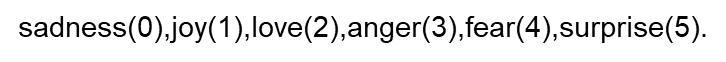
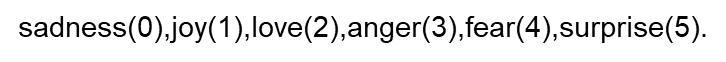
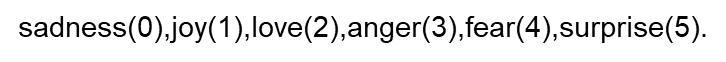
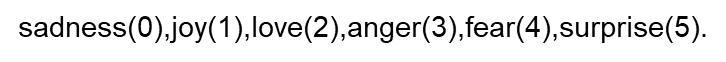

In [16]:
# Iterate over each context using a for loop outside the function
for context in contexts:
    result = emotion_analysis_with_explanation(context, classification_pipeline, qa_pipeline, label_mapping)
    emotion=result['detected_emotion']
    exp = explain_emotion_with_lime(context, emotion, classifier_tokenizer, classifier_model, device)
    exp.show_in_notebook(text=context)
    explain_emotion_with_shap(context, classifier_model, classifier_tokenizer)
    generate_emotion_highlight_html(context, emotion_lexicon, att_dict)
    
    print('-' * 200)



Text for Classification: His mother had begun to feel very angry about his refusal to eat as he had started to lose weight , which worried her . 
Detected Emotion: anger
Generated Question: Why does this sentence express anger?
Emotion Reason: about his refusal to eat


`return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.


  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:45, 45.82s/it]               


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Text for Classification: Concerned as to whether he was adequately looking after himself , but especially concerned as to his future as a writer
Detected Emotion: fear
Generated Question: Why does this sentence express fear?
Emotion Reason: to his future as a writer


`return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.


  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:33, 33.23s/it]               


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Text for Classification: Upon hearing the news about the promotion, I was truly astonished at how much I had achieved in such a short amount of time, given all the challenges 
Detected Emotion: surprise
Generated Question: Why does this sentence express surprise?
Emotion Reason: at how much I had achieved


`return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.


  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:43, 43.84s/it]               


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Text for Classification: Smiling across the room at Laura 's tall , slender figure , she added , ` Besides , everyone in your office was so pleased at your promotion 
Detected Emotion: happy
Generated Question: Why does this sentence express happy?
Emotion Reason: at your promotion


`return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.


  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:45, 45.10s/it]               


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Text for Classification: At least we know what hell we will be going through in the next four years.It's going to be a sad sad diffcult time here
Detected Emotion: sad
Generated Question: Why does this sentence express sad?
Emotion Reason: At least we know what hell


`return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.


  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:47, 47.45s/it]               


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Text for Classification: Buy this if u have money to spend on junk stuff that you are no going to use. I never knew halogen light was so dull. I dont believe personally that this has a halogen bulb. 
Detected Emotion: anger
Generated Question: Why does this sentence express anger?
Emotion Reason: to spend on junk stuff


`return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.


  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:54, 54.85s/it]               


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Text for Classification: bought 2,guess I will trash them. does not work in Bunn nor regular timed coffee pot. Would not buy again
Detected Emotion: anger
Generated Question: Why does this sentence express anger?
Emotion Reason: again


`return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.


  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:46, 46.32s/it]               


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Text for Classification: Do not waste your time with this book, it is fake junk history! Read Lincoln's own writing if you want to know what he really felt or wanted for the U.S. and world. 
Detected Emotion: anger
Generated Question: Why does this sentence express anger?
Emotion Reason: with this book, it is fake junk history


`return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.


  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [00:58, 58.58s/it]               


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
Text for Classification: I was very disappointed to discover that the copies, (I ordered the scary trilogy)while described as being illustrated by Stephen Gammell, were actually the updated versions with watered-down artwork by another artist. I am not keeping this books as they are worthless to me without the better artwork. This is the first time I've been disappointed with an order from Amazon, but it's a big one. You need to change your description to include the correct illustrator.
Detected Emotion: fear
Generated Question: Why does this sentence express fear?
Emotion Reason: to discover that the copies


`return_all_scores` is now deprecated,  if want a similar functionality use `top_k=None` instead of `return_all_scores=True` or `top_k=1` instead of `return_all_scores=False`.


  0%|          | 0/498 [00:00<?, ?it/s]

PartitionExplainer explainer: 2it [02:14, 134.72s/it]              


--------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------


**irrevelant code**

In [17]:
print("hi")

hi


In [18]:
# Save explanation to file
html_file_path = os.path.join(save_directory, "file_name.html")
exp.save_to_file(html_file_path, labels=[label_index])

# Save explanation as a plot
plot_file_path = os.path.join(save_directory, "file_name.png")
exp.as_pyplot_figure(label=label_index).savefig(plot_file_path)

NameError: name 'os' is not defined

In [ ]:
# Show explanation in notebook
exp.show_in_notebook(text=context)

In [ ]:
# Example data
context = test_data.context.iloc[4]
ground_truth=test_data.answer.iloc[4]